In [40]:
import numpy as np
from sklearn . datasets import make_blobs , make_circles , make_moons

# # Dane 1
n = 1500
Xb , yb = make_blobs ( n_samples = n )
# # Dane 2
noise = 0.05
Xc , yc = make_circles ( n_samples = n , factor = 0.5 , noise = noise )
# # Dane 3
noise = 0.05
Xm , ym = make_moons ( n_samples = n , noise = noise )
# # Dane 4
X_rand = np . random . rand (n , 2)

In [2]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import roc_auc_score
from sklearn.preprocessing import StandardScaler
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.pipeline import Pipeline

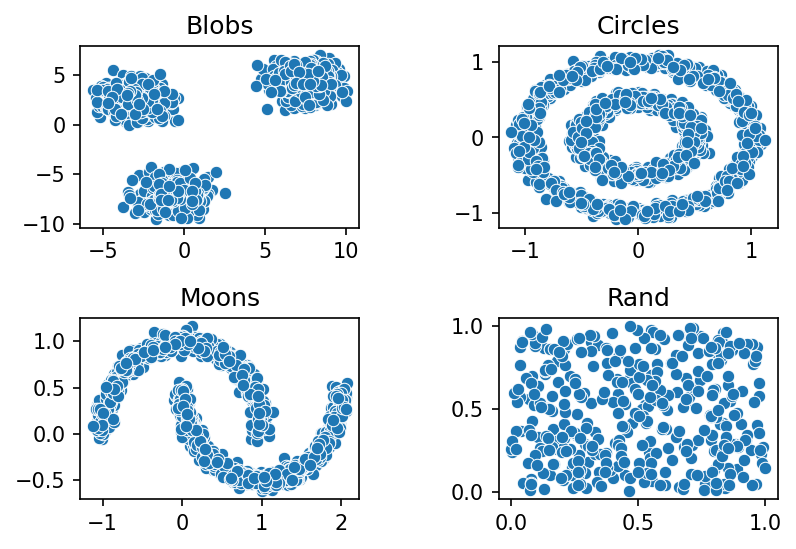

In [160]:
fig, ax = plt.subplots()
ax.set_xticks([])
ax.set_yticks([])

plt.subplot(2,2,1)
sns.scatterplot(x = Xb[:,0], y = Xb[:,1])
plt.title('Blobs')

plt.subplot(2,2,2)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1])
plt.title('Circles')

plt.subplot(2,2,3)
sns.scatterplot(x = Xm[:,0], y = Xm[:,1])
plt.title('Moons')

plt.subplot(2,2,4)
sns.scatterplot(x = X_rand[::4,0], y = X_rand[::4,1])
plt.title('Rand')

plt.subplots_adjust(hspace=0.5, wspace=0.5)
plt.savefig('prezentacjaZbiorow.pdf')

## Pytanie 1.
Algorytm k-średnich wymaga sprecyzowania, iloma klastrami chcemy sklasyfikować zbiór. 

# 1.1 Metoda k-średnich

<Figure size 2250x2250 with 0 Axes>

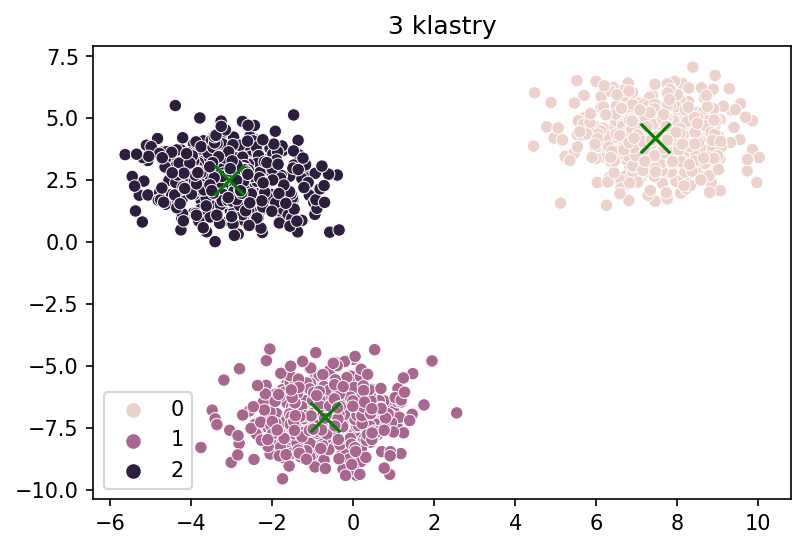

<Figure size 2250x2250 with 0 Axes>

In [83]:
ml2 = KMeans(n_clusters=3).fit(Xb)
sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('3 klastry')
plt.savefig('blobs11.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

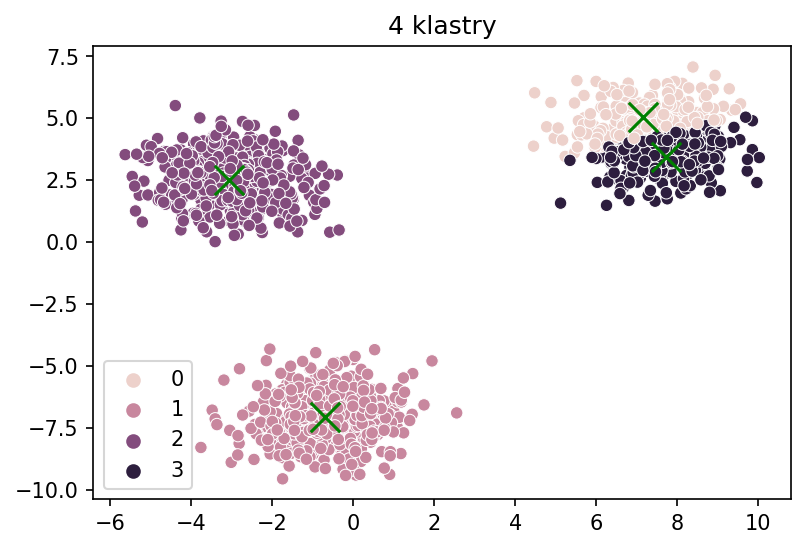

<Figure size 2250x2250 with 0 Axes>

In [84]:
ml2 = KMeans(n_clusters=4).fit(Xb)
sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('4 klastry')
plt.savefig('blobs12.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

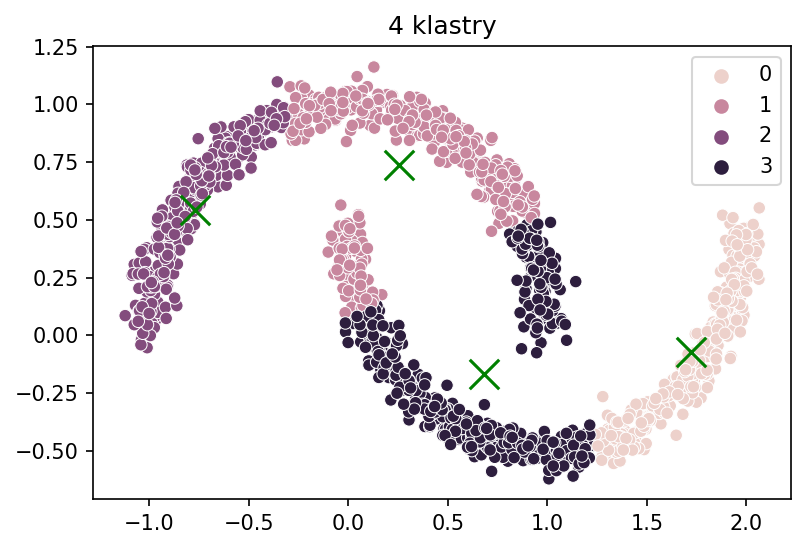

<Figure size 2250x2250 with 0 Axes>

In [77]:
ml2 = KMeans(n_clusters=4).fit(Xm)
sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('4 klastry')
plt.savefig('moons11.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

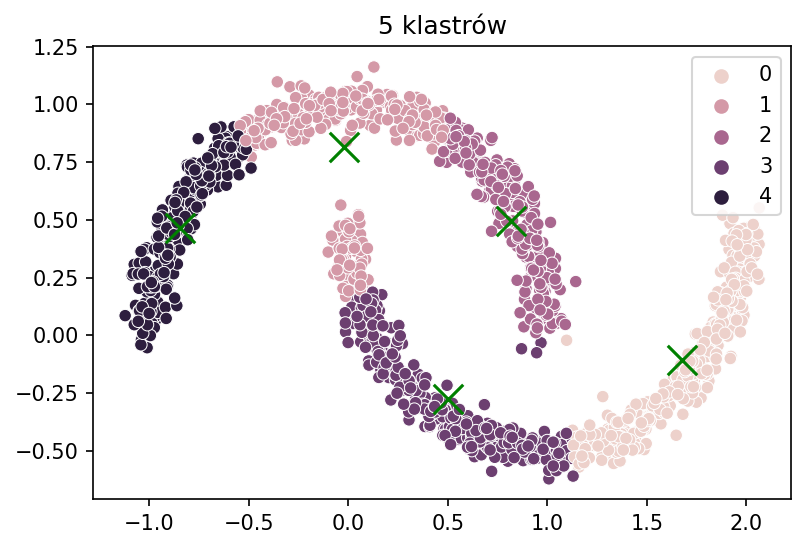

<Figure size 2250x2250 with 0 Axes>

In [78]:
ml2 = KMeans(n_clusters=5).fit(Xm)
sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('5 klastrów')
plt.savefig('moons12.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

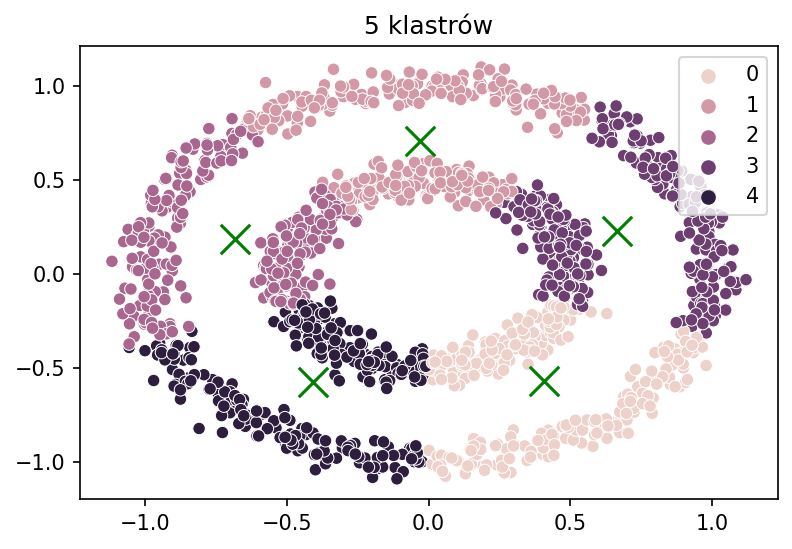

<Figure size 2250x2250 with 0 Axes>

In [79]:
ml2 = KMeans(n_clusters=5).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('5 klastrów')
plt.legend(loc='upper right')
plt.savefig('circles11.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

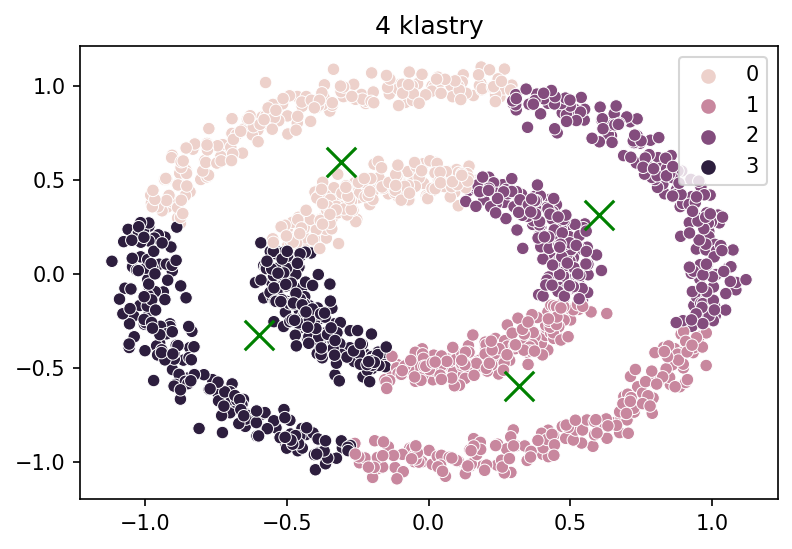

<Figure size 2250x2250 with 0 Axes>

In [75]:
ml2 = KMeans(n_clusters=4).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('4 klastry')
plt.legend(loc='upper right')
plt.savefig('circles12.pdf')
plt.figure(figsize=(15,15))

W ostatnim przykładzie na pierwszy rzut oka na ten wykres wydaje się rozsądnym wybrać 4 klastry. Jakie one są i jak wygląda podział takiego zbioru na 4 klastry?

<Figure size 2250x2250 with 0 Axes>

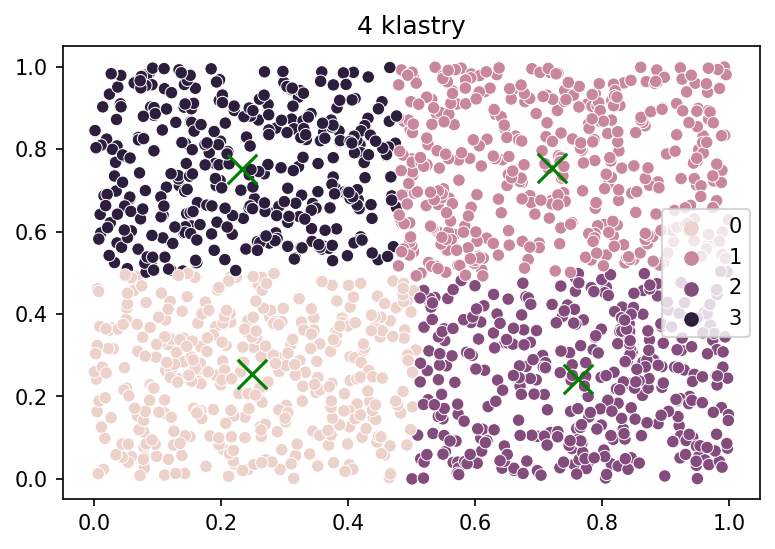

<Figure size 2250x2250 with 0 Axes>

In [80]:
ml2 = KMeans(n_clusters=4).fit(X_rand)
sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('4 klastry')
plt.savefig('rand11.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

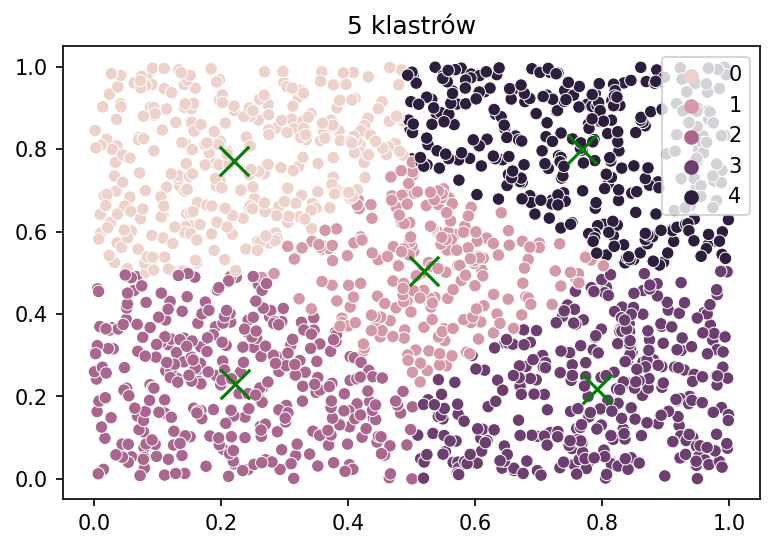

<Figure size 2250x2250 with 0 Axes>

In [82]:
ml3 = KMeans(n_clusters=5).fit(X_rand)
sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=ml3.labels_)
for point in ml3.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('5 klastrów')
plt.savefig('rand12.pdf')
plt.figure(figsize=(15,15))

<Figure size 1080x1080 with 0 Axes>

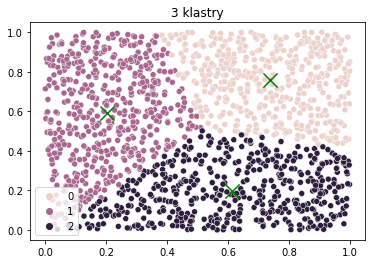

<Figure size 1080x1080 with 0 Axes>

In [10]:
ml2 = KMeans(n_clusters=3).fit(X_rand)
sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=ml2.labels_)
for point in ml2.cluster_centers_:
    plt.scatter(*point, color='green', marker='x', s=200)
# sns.scatterplot(x=ml2.cluster_centers_[:,0], y=ml2.cluster_centers_[:,1], marker = 'x', size=ml2.cluster_centers_[:,1], sizes = (30,30))
plt.title('3 klastry')
plt.figure(figsize=(15,15))

# 1.2 Metody hierarchiczne

<Figure size 2250x2250 with 0 Axes>

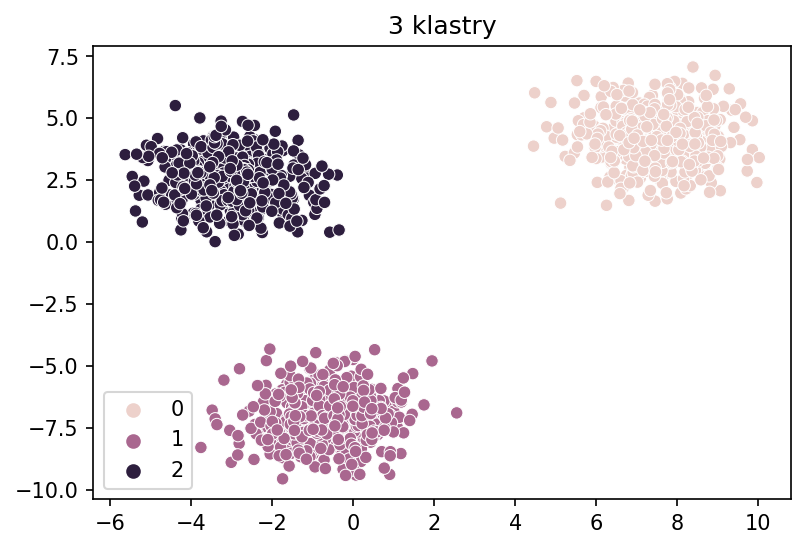

<Figure size 2250x2250 with 0 Axes>

In [133]:
from sklearn.cluster import AgglomerativeClustering

Z1 = AgglomerativeClustering(n_clusters=3, linkage='single')
Z1.fit_predict(Xb)

sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=Z1.labels_)
plt.title('3 klastry')
plt.savefig('blobsHier1.pdf')
plt.figure(figsize=(15,15))



<Figure size 2250x2250 with 0 Axes>

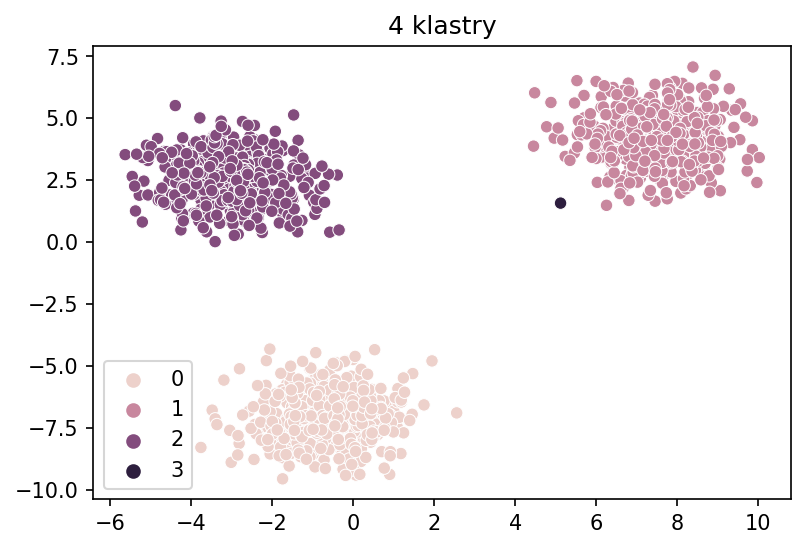

<Figure size 2250x2250 with 0 Axes>

In [132]:
Z1 = AgglomerativeClustering(n_clusters=4, linkage='single')
Z1.fit_predict(Xb)

sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=Z1.labels_)
plt.title('4 klastry')
plt.savefig('blobsHier2.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

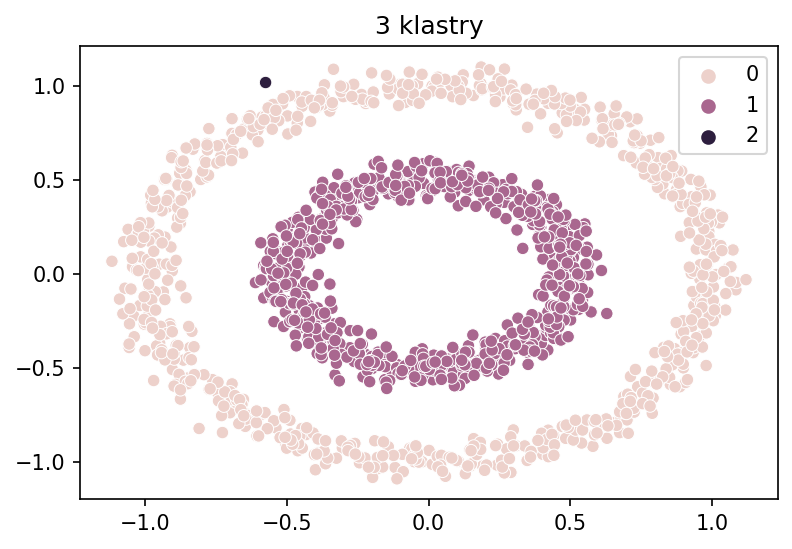

<Figure size 2250x2250 with 0 Axes>

In [137]:
Z1 = AgglomerativeClustering(n_clusters=3, linkage='single')
Z1.fit_predict(Xc)

sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=Z1.labels_)
plt.title('3 klastry')
plt.savefig('circlesHier1.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

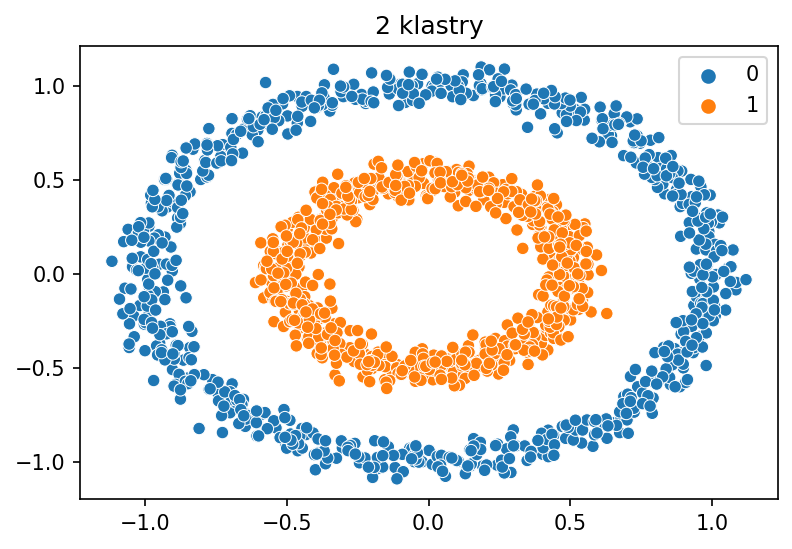

<Figure size 2250x2250 with 0 Axes>

In [136]:
Z1 = AgglomerativeClustering(n_clusters=2, linkage='single')
Z1.fit_predict(Xc)

sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=Z1.labels_)
plt.title('2 klastry')
plt.savefig('circlesHier2.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

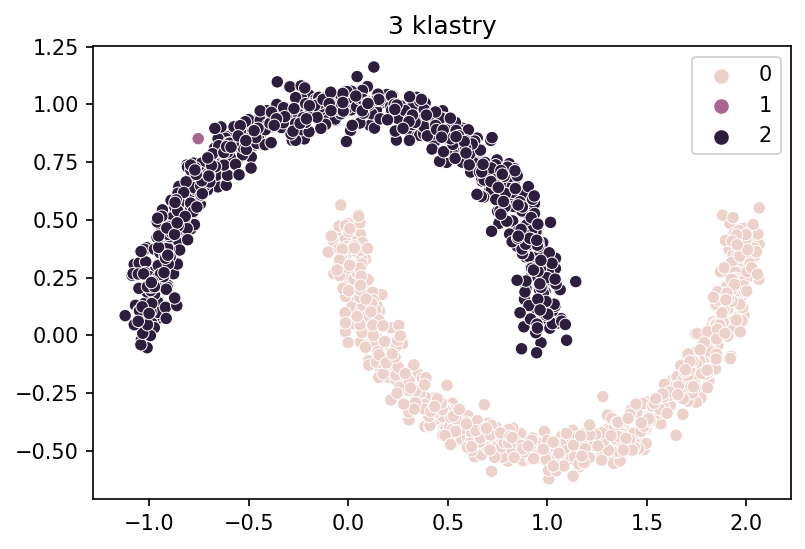

<Figure size 2250x2250 with 0 Axes>

In [141]:
Z1 = AgglomerativeClustering(n_clusters=3, linkage='single')
Z1.fit_predict(Xm)

sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=Z1.labels_)
plt.title('3 klastry')
plt.savefig('moonsHier1.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

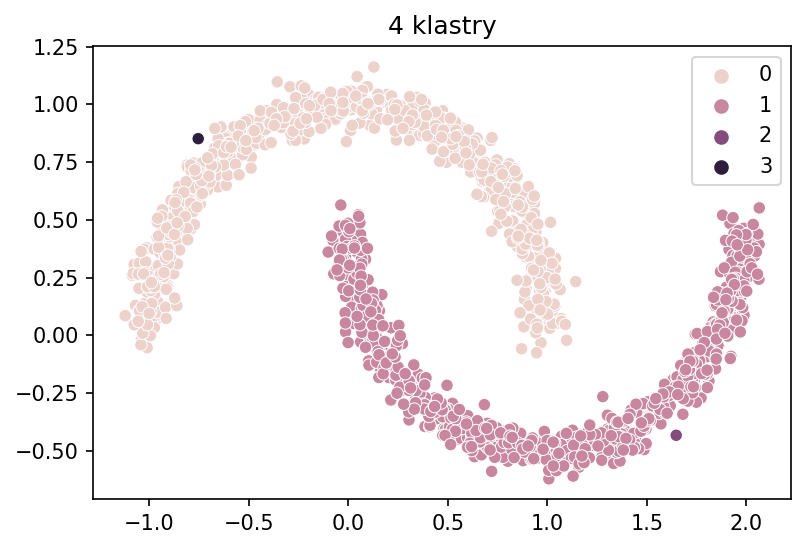

<Figure size 2250x2250 with 0 Axes>

In [140]:
Z1 = AgglomerativeClustering(n_clusters=4, linkage='single')
Z1.fit_predict(Xm)

sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=Z1.labels_)
plt.title('4 klastry')
plt.savefig('moonsHier2.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

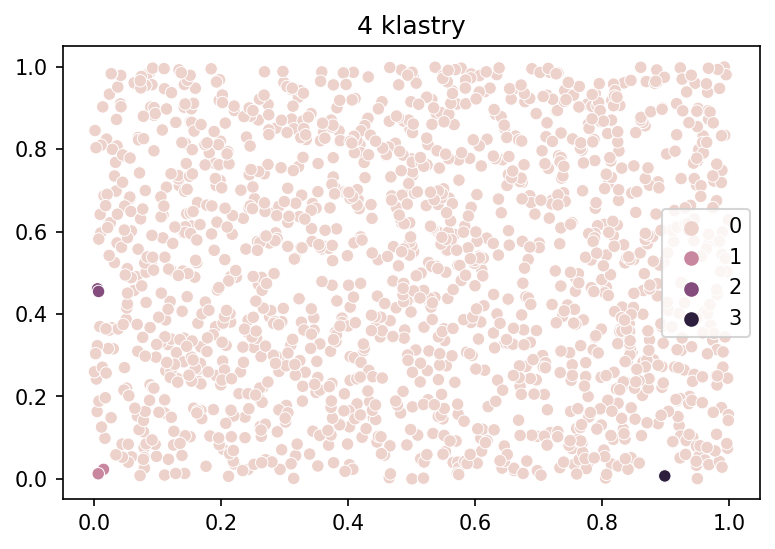

<Figure size 2250x2250 with 0 Axes>

In [145]:
Z1 = AgglomerativeClustering(n_clusters=4, linkage='single')
Z1.fit_predict(X_rand)

sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=Z1.labels_)
plt.title('4 klastry')
plt.savefig('randHier1.pdf')
plt.figure(figsize=(15,15))

<Figure size 2250x2250 with 0 Axes>

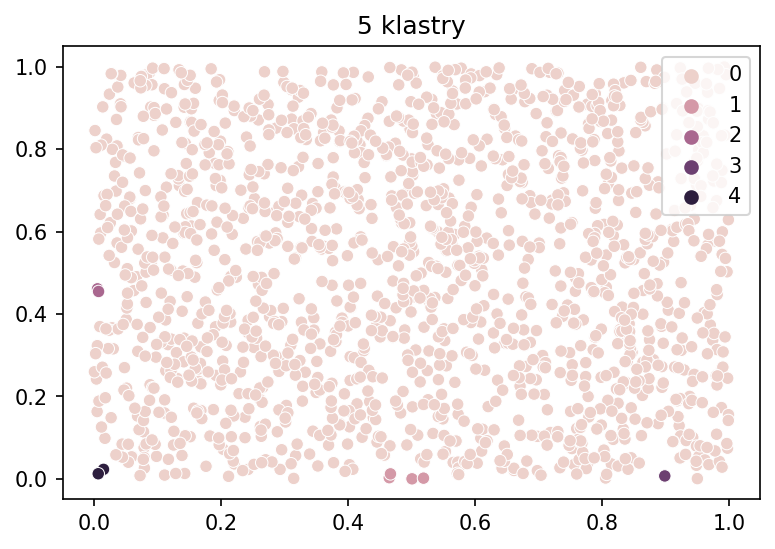

<Figure size 2250x2250 with 0 Axes>

In [144]:
Z1 = AgglomerativeClustering(n_clusters=5, linkage='single')
Z1.fit_predict(X_rand)

sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=Z1.labels_)
plt.title('5 klastry')
plt.savefig('randHier2.pdf')
plt.figure(figsize=(15,15))

# 1.3 DBSCAN

## Circles

In [35]:
from sklearn.cluster import DBSCAN

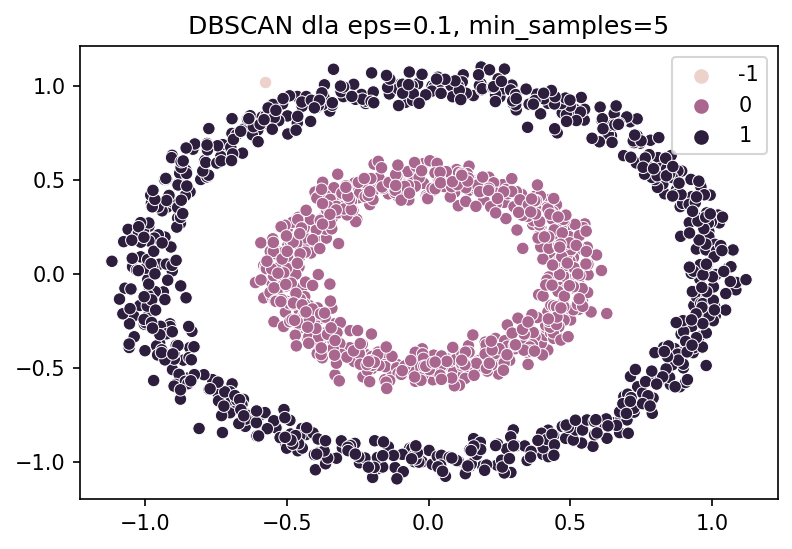

In [66]:
m = DBSCAN(eps = 0.1, min_samples=5).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.1, min_samples=5')
plt.savefig('db0.pdf')

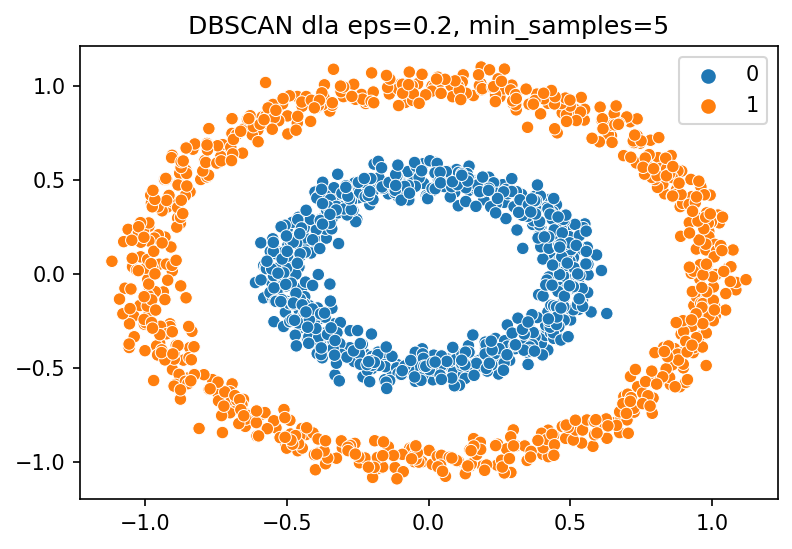

In [64]:
m = DBSCAN(eps = 0.2, min_samples=5).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.2, min_samples=5')
plt.savefig('db1.pdf')

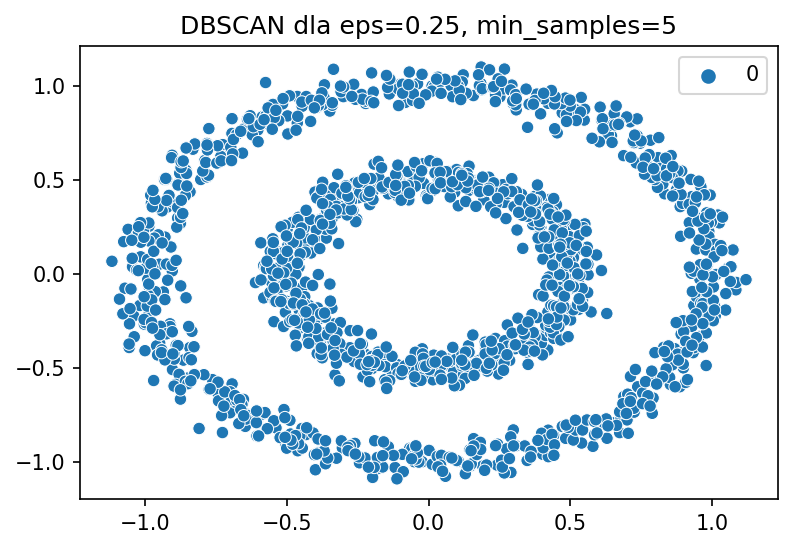

In [63]:
m = DBSCAN(eps = 0.25, min_samples=5).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.25, min_samples=5')
plt.savefig('db2.pdf')

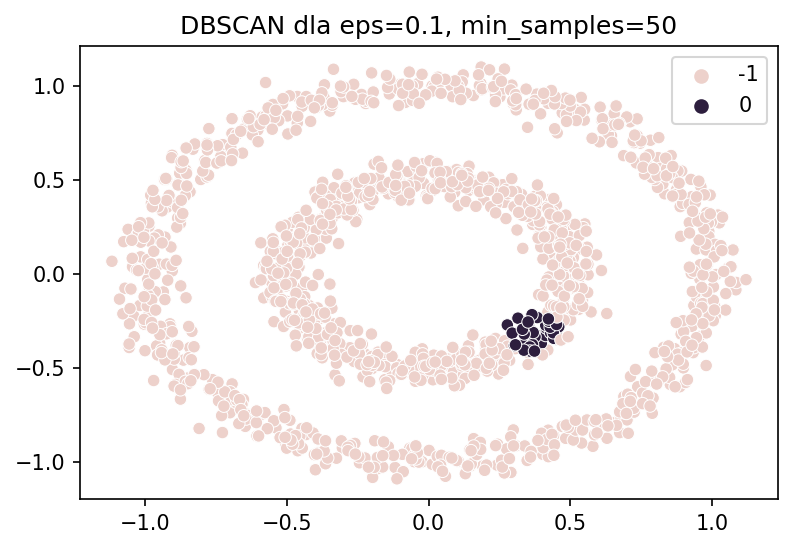

In [70]:
m = DBSCAN(eps = 0.1, min_samples=50).fit(Xc)
sns.scatterplot(x = Xc[:,0], y = Xc[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.1, min_samples=50')
plt.savefig('db3.pdf')

## Moons

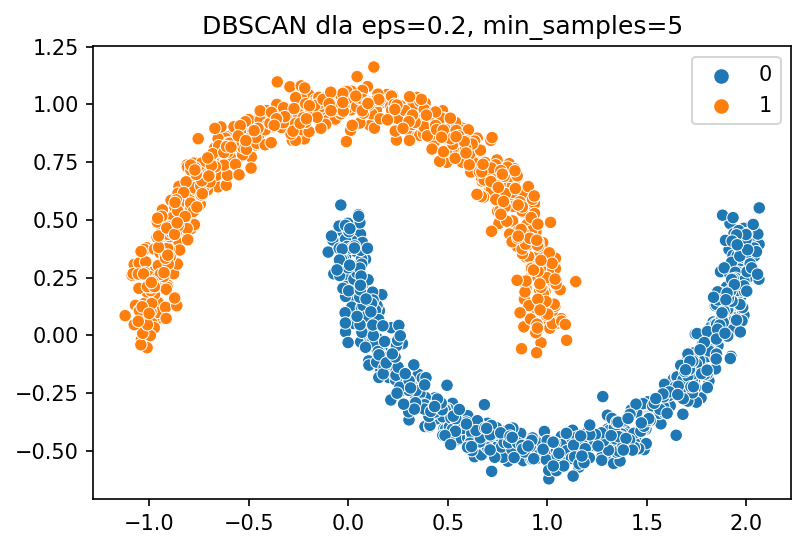

In [109]:
m = DBSCAN(eps = 0.2, min_samples=5).fit(Xm)
sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.2, min_samples=5')
plt.savefig('dbm1.pdf')

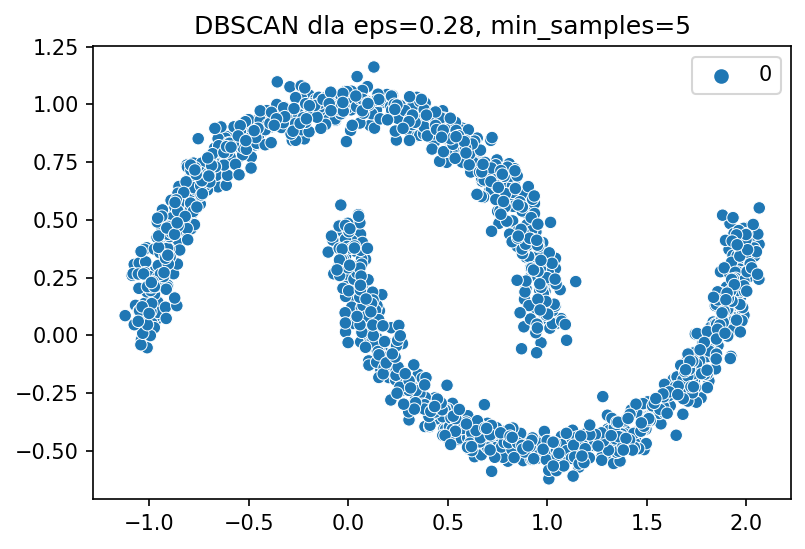

In [89]:
m = DBSCAN(eps = 0.28, min_samples=5).fit(Xm)
sns.scatterplot(x = Xm[:,0], y = Xm[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.28, min_samples=5')
plt.savefig('dbm2.pdf')

## Blobs

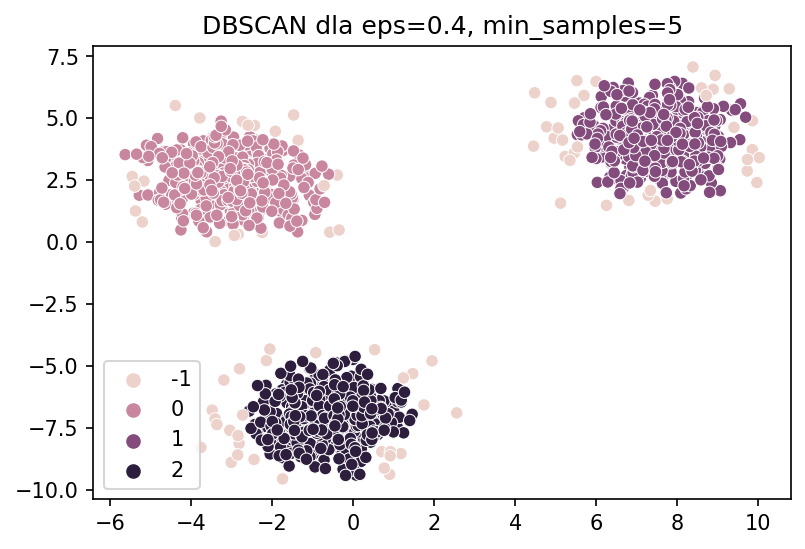

In [100]:
m = DBSCAN(eps = 0.4, min_samples=5).fit(Xb)
sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.4, min_samples=5')
plt.savefig('dbb1.pdf')

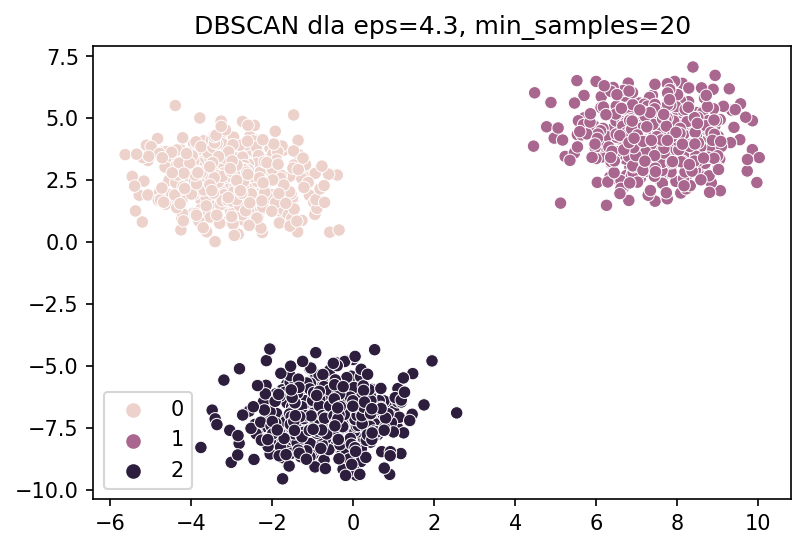

In [99]:
m = DBSCAN(eps = 4.3, min_samples=20).fit(Xb)
sns.scatterplot(x = Xb[:,0], y = Xb[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=4.3, min_samples=20')
plt.savefig('dbb2.pdf')

## Rand

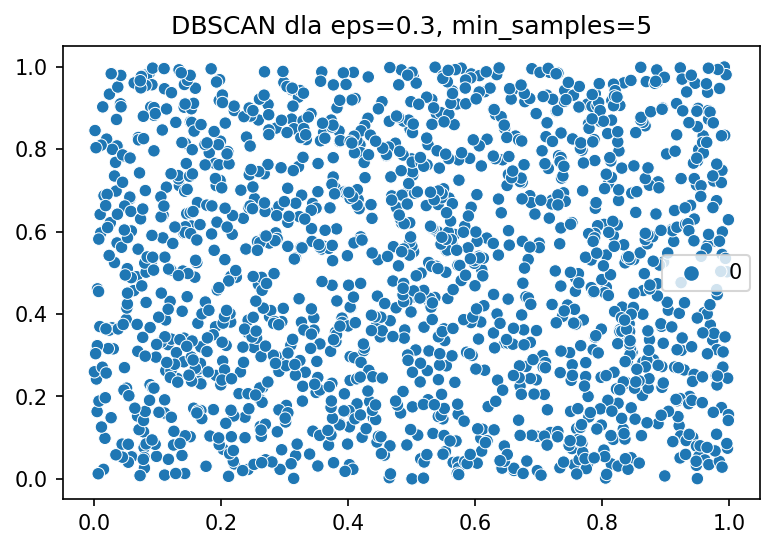

In [108]:
m = DBSCAN(eps = 0.05, min_samples=5).fit(X_rand)
sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.3, min_samples=5')
plt.savefig('dbr1.pdf')

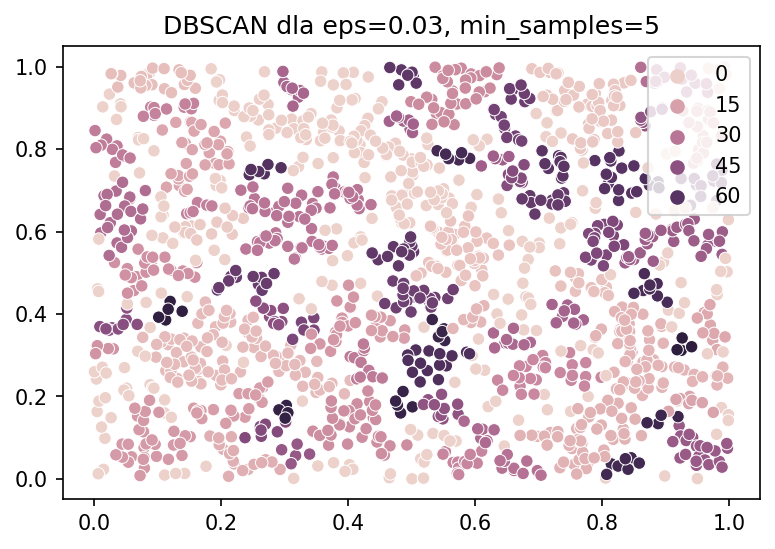

In [106]:
m = DBSCAN(eps = 0.03, min_samples=5).fit(X_rand)
sns.scatterplot(x = X_rand[:,0], y = X_rand[:,1], hue=m.labels_)
plt.title('DBSCAN dla eps=0.03, min_samples=5')
plt.savefig('dbr2.pdf')

# Pytanie 2
Zbadaj wpływ parametr ``noise`` dla zestawów danych 2 i 3.

## Zbiór Circle

In [20]:
Xc_tab = []
yc_tab = []
Xm_tab = []
ym_tab = []
max_iter = 20
for i in range(max_iter):
    Xc , yc = make_circles ( n_samples = n , factor = 0.5 , noise = .01*i )
    Xc_tab.append(Xc)
    yc_tab.append(yc)
    Xm , ym = make_moons ( n_samples = n , noise = .01*i )
    Xm_tab.append(Xm)
    ym_tab.append(ym)

### Do animacji tutaj:

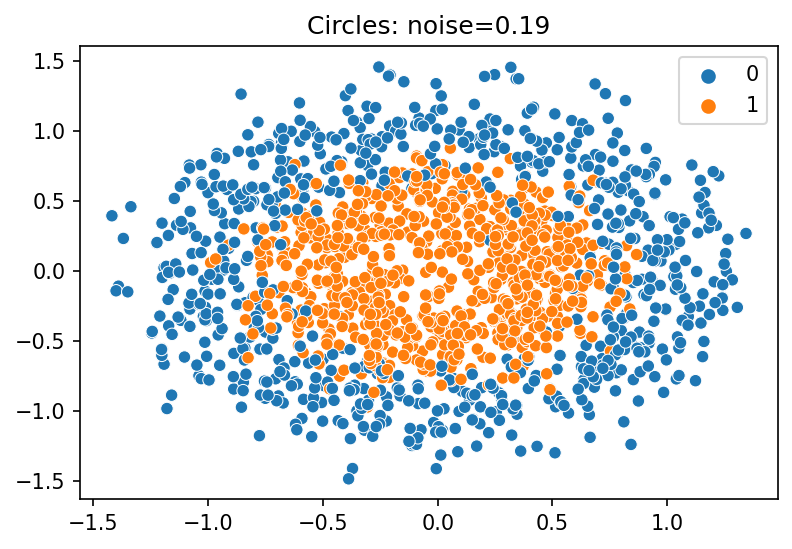

In [21]:
from matplotlib.animation import FuncAnimation
plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

i = 0
def animate(t):
    global i
    plt.cla()
    sns.scatterplot(x=Xc_tab[i][:,0], y=Xc_tab[i][:,1], hue=yc_tab[i])
    plt.title(f'Circles: noise={.01*i}')
    i += 1
    

FuncAnimation(fig, animate, frames=19)

### Do zapisania w gifie animacji: 

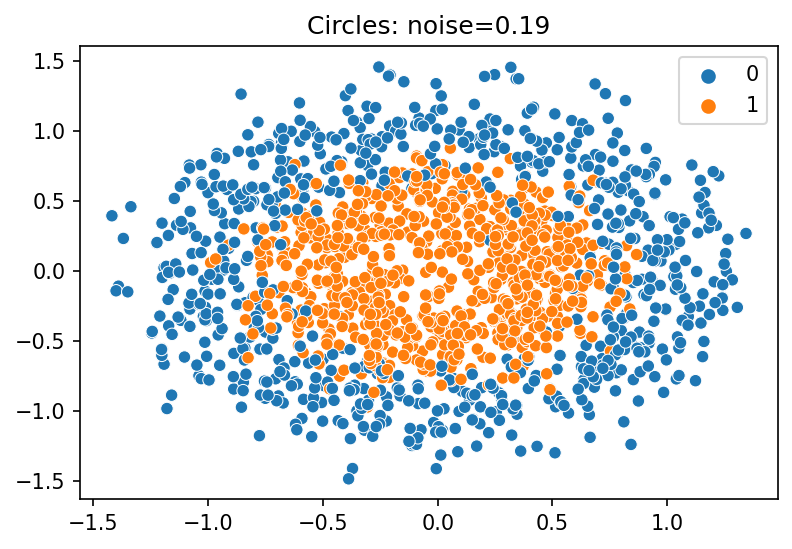

In [22]:
import matplotlib.animation

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

i = 0
def animate(t):
    global i
    plt.cla()
    sns.scatterplot(x=Xc_tab[i][:,0], y=Xc_tab[i][:,1], hue=yc_tab[i])
    plt.title(f'Circles: noise={.01*i}')
    i += 1
    

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=19)
ani.save('./last_frame.gif', writer='pillow')

Przykładowe snapshoty:

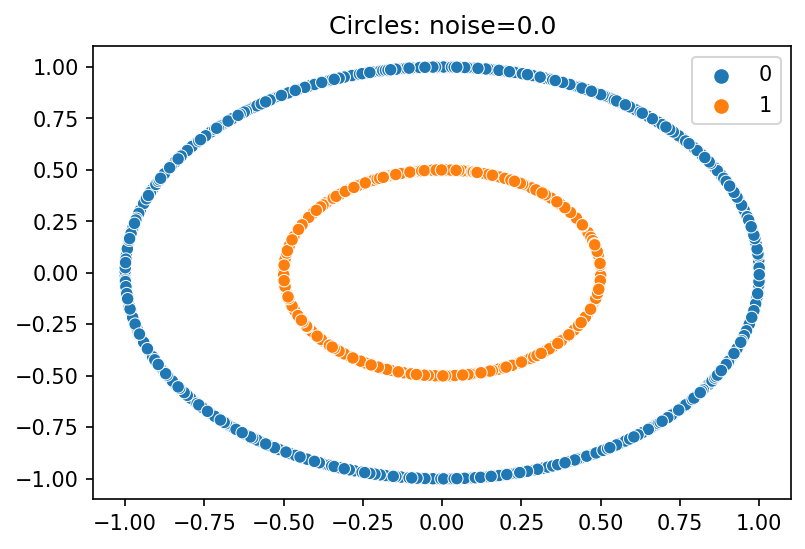

In [24]:
sns.scatterplot(x=Xc_tab[0][:,0], y=Xc_tab[0][:,1], hue=yc_tab[0])
plt.title(f'Circles: noise={.01*0}')
plt.savefig('circ0.pdf')

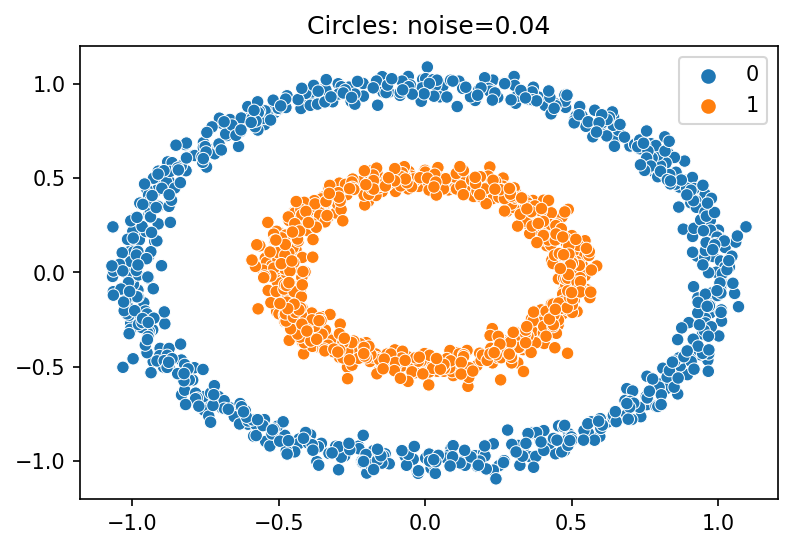

In [26]:
sns.scatterplot(x=Xc_tab[4][:,0], y=Xc_tab[4][:,1], hue=yc_tab[4])
plt.title(f'Circles: noise={.01*4}')
plt.savefig('circ4.pdf')

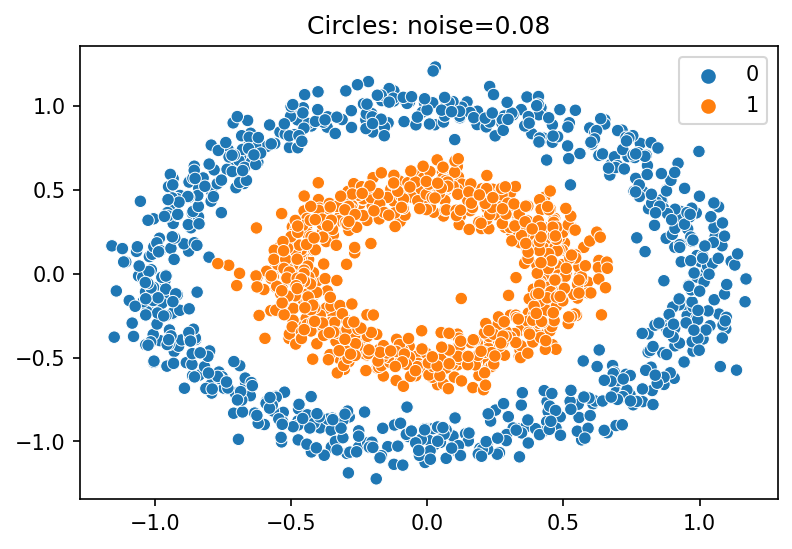

In [27]:
sns.scatterplot(x=Xc_tab[8][:,0], y=Xc_tab[8][:,1], hue=yc_tab[8])
plt.title(f'Circles: noise={.01*8}')
plt.savefig('circ8.pdf')

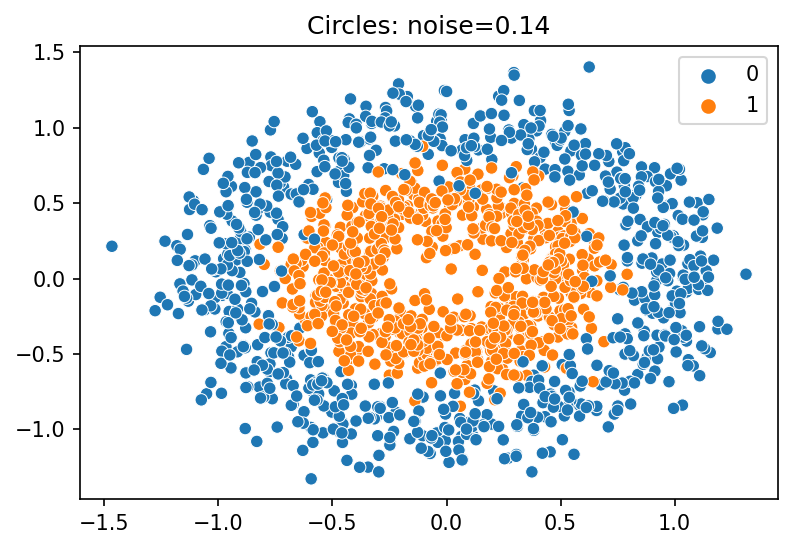

In [28]:
sns.scatterplot(x=Xc_tab[14][:,0], y=Xc_tab[14][:,1], hue=yc_tab[14])
plt.title(f'Circles: noise={.01*14}')
plt.savefig('circ14.pdf')

## Zbiór Moon

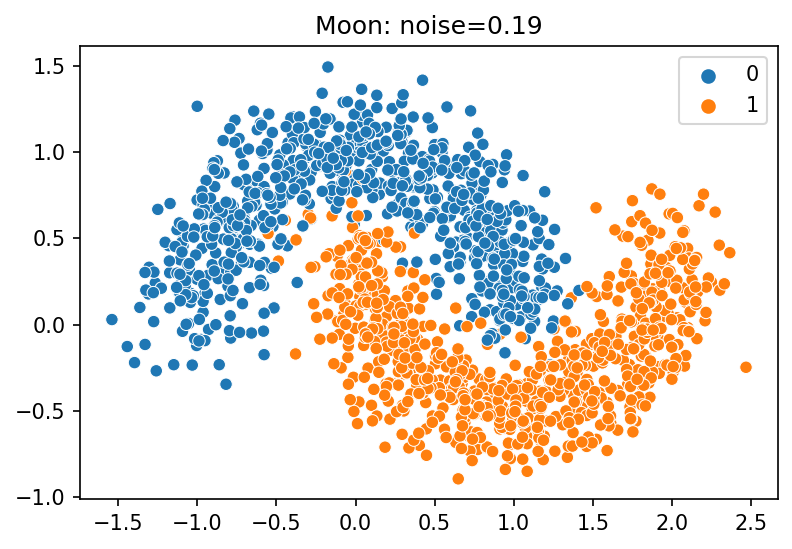

In [29]:
import matplotlib.animation

plt.rcParams["animation.html"] = "jshtml"
plt.rcParams['figure.dpi'] = 150  
plt.ioff()
fig, ax = plt.subplots()

i = 0
def animate(t):
    global i
    plt.cla()
    sns.scatterplot(x=Xm_tab[i][:,0], y=Xm_tab[i][:,1], hue = ym_tab[i])
    plt.title(f'Moon: noise={.01*i}')
    i += 1

matplotlib.animation.FuncAnimation(fig, animate, frames=19)

Pare przypadków oddzielnie na wykresach:

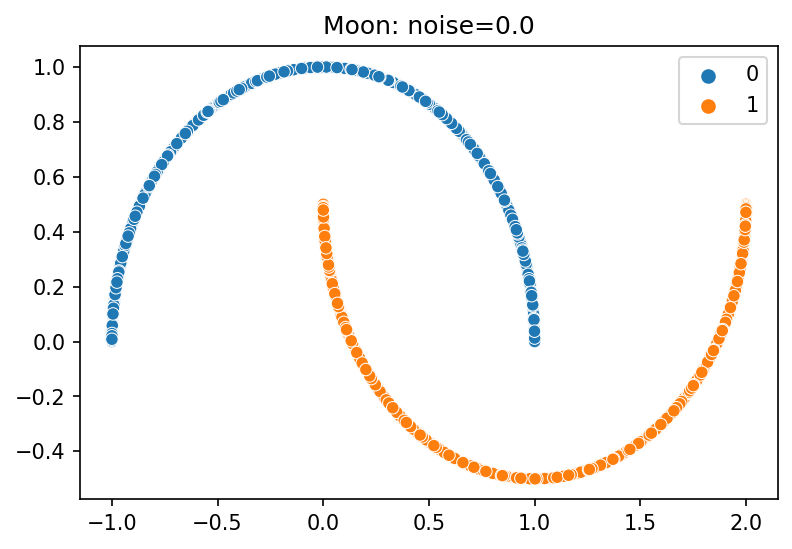

In [31]:
sns.scatterplot(x=Xm_tab[0][:,0], y=Xm_tab[0][:,1], hue=ym_tab[0])
plt.title(f'Moon: noise={.01*0}')
plt.savefig('moon0.pdf')

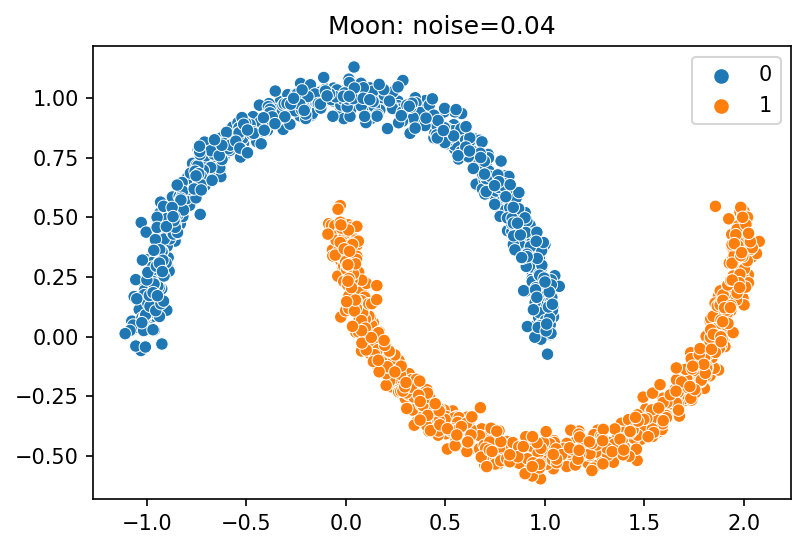

In [32]:
sns.scatterplot(x=Xm_tab[4][:,0], y=Xm_tab[4][:,1], hue=ym_tab[4])
plt.title(f'Moon: noise={.01*4}')
plt.savefig('moon4.pdf')

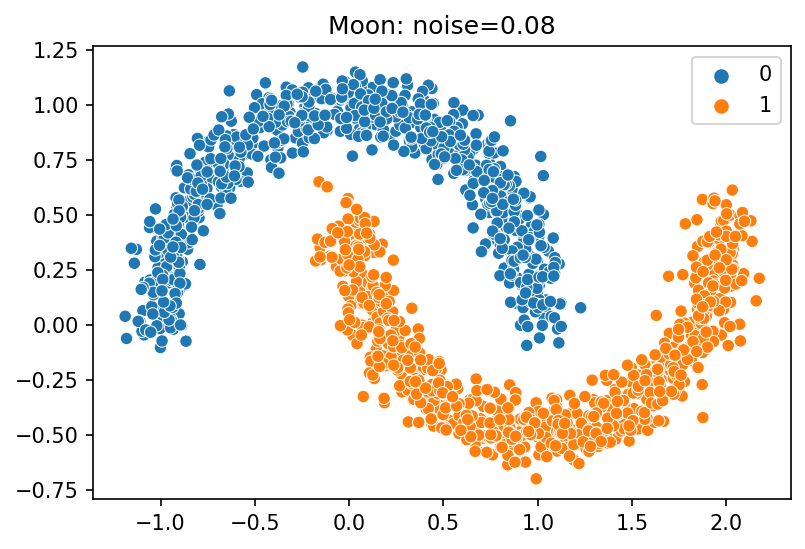

In [33]:
sns.scatterplot(x=Xm_tab[8][:,0], y=Xm_tab[8][:,1], hue=ym_tab[8])
plt.title(f'Moon: noise={.01*8}')
plt.savefig('moon8.pdf')

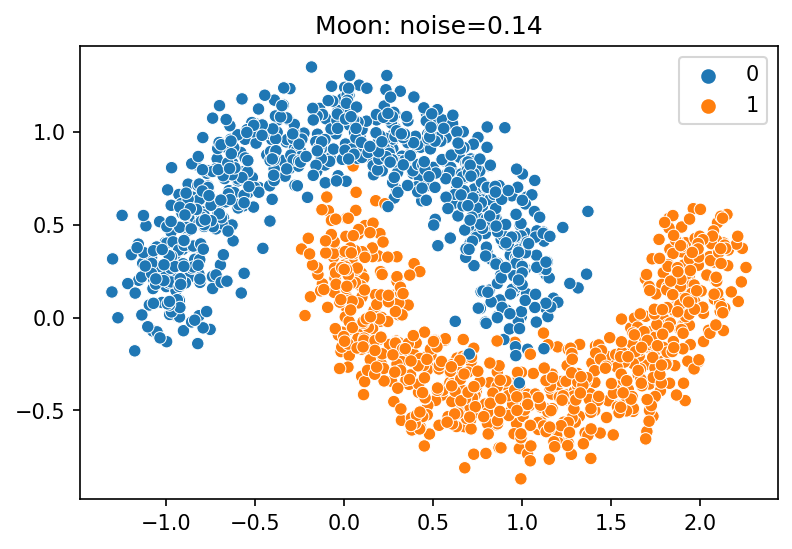

In [34]:
sns.scatterplot(x=Xm_tab[14][:,0], y=Xm_tab[14][:,1], hue=ym_tab[14])
plt.title(f'Moon: noise={.01*14}')
plt.savefig('moon14.pdf')

# Pytanie 3

## Metoda k-średnich

Jak wybór liczności tych klastrów wpływa na wyniki?

In [3]:
import os
os.environ["OMP_NUM_THREADS"] = '6'

In [4]:
inertias = []
labels = ['blobs', 'circles','moon', 'rand']
colors = ['g', 'r', 'b', 'g']
for train_set in [Xb, Xc, Xm, X_rand]:
    inertias_temp = []
    for i in range(2,11):
        m = KMeans(n_clusters = i).fit(train_set)
        # m.cluster_centers_
        inertias_temp.append(m.inertia_)
    inertias.append(inertias_temp)

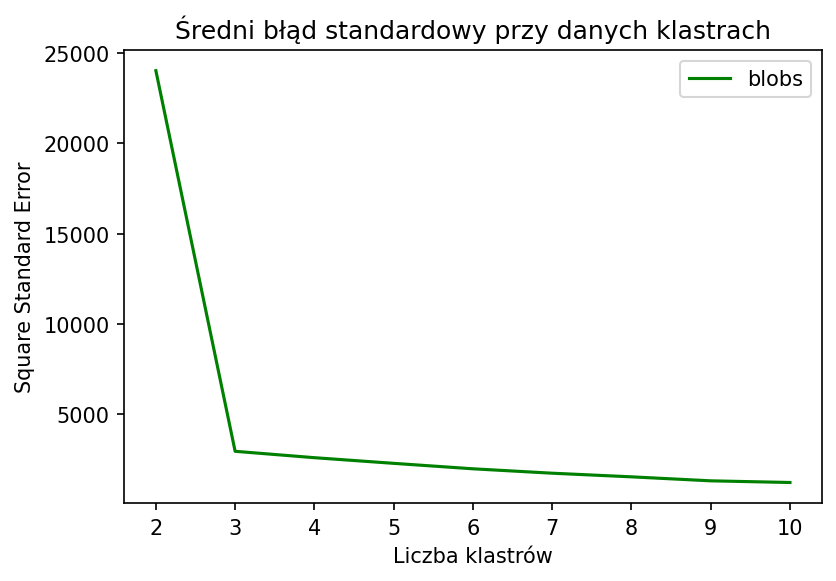

In [110]:
plt.plot(np.arange(2,11), inertias[0], colors[0], label = labels[0])
plt.legend()
plt.xlabel('Liczba klastrów')
plt.ylabel('Square Standard Error')
plt.title('Średni błąd standardowy przy danych klastrach')
plt.savefig('kmProblem3.pdf')

Widać, że przy 3 linia zmienia drastycznie nachylenie, spłaszcza się i już dalej maleje, mniej więcej, pod tym samym nachyleniem. Stąd widać, że najkorzystniej wybrać 3 klastry.

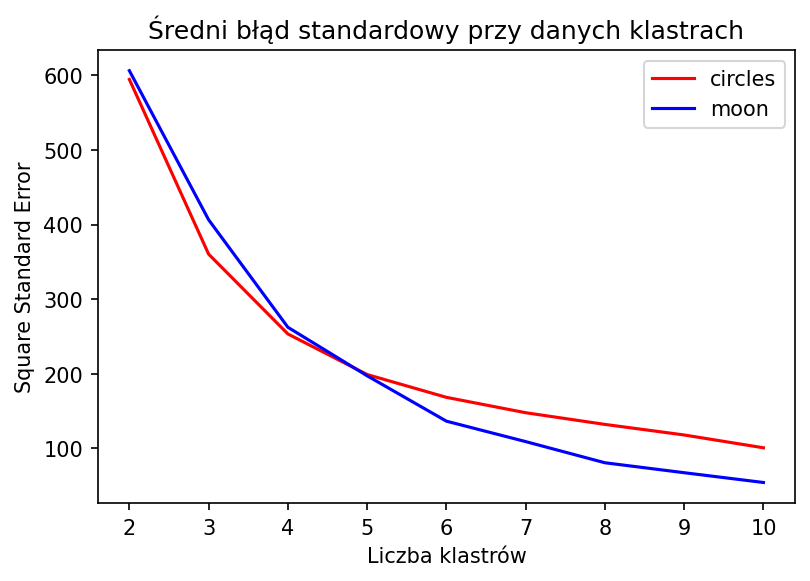

In [111]:
# plt.yscale("log")
for i in range(1,len(inertias)-1):
    plt.plot(np.arange(2,11), inertias[i], colors[i], label = labels[i])
    plt.legend()
    plt.xlabel('Liczba klastrów')
    plt.ylabel('Square Standard Error')
    plt.title('Średni błąd standardowy przy danych klastrach')
    plt.savefig('kmProblem32.pdf')

Wydaje się, że w obu przypadkach przy wyborze pięciu klastrów będzie okej, jednakże ten wybór nie jest oczywisty.

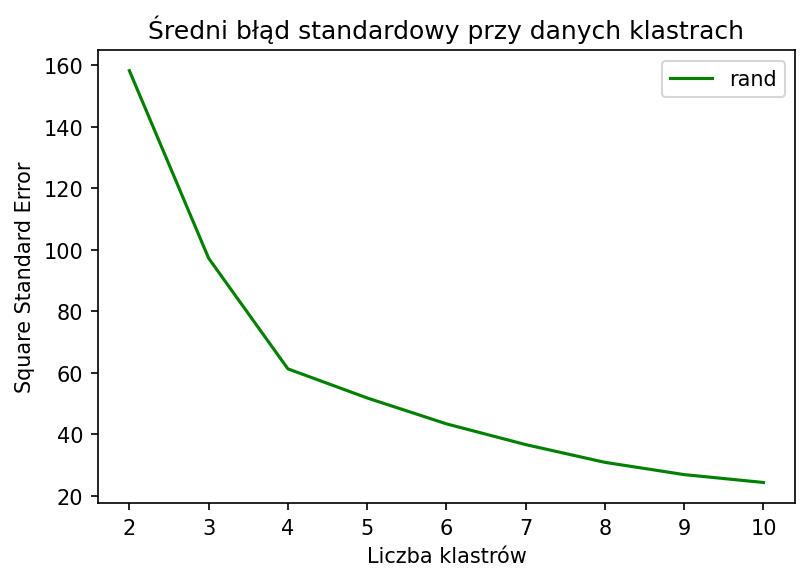

In [112]:
plt.plot(np.arange(2,11), inertias[3], colors[3], label = labels[3])
plt.legend()
plt.xlabel('Liczba klastrów')
plt.ylabel('Square Standard Error')
plt.title('Średni błąd standardowy przy danych klastrach')
plt.savefig('kmProblem33.pdf')

## DBSCAN

In [ ]:
inertias = []
labels = ['blobs', 'circles','moon', 'rand']
colors = ['g', 'r', 'b', 'g']
for train_set in [Xb, Xc, Xm, X_rand]:
    inertias_temp = []
    for i in range(2,11):
        m = DBSCAN(n_clusters = i).fit(train_set)
        # m.cluster_centers_
        inertias_temp.append(m.inertia_)
    inertias.append(inertias_temp)

### Metody hierarchiczne

In [114]:
from scipy.cluster.hierarchy import dendrogram, linkage

Text(0.5, 1.0, 'Single')

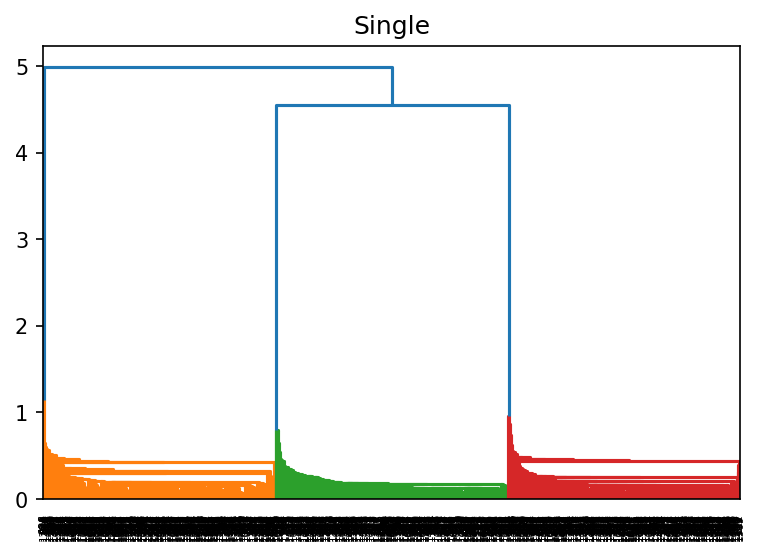

In [123]:
Z1 = linkage(Xb, method='single', metric='euclidean')

plt.subplots()
dendrogram(Z1)
plt.title('Single')

In [121]:
Z1.shape

(1499, 4)

In [122]:
Z1

array([[9.33000000e+02, 1.08100000e+03, 3.52457415e-03, 2.00000000e+00],
       [6.65000000e+02, 1.00600000e+03, 4.54410639e-03, 2.00000000e+00],
       [5.83000000e+02, 1.03100000e+03, 6.84831391e-03, 2.00000000e+00],
       ...,
       [9.96000000e+02, 2.98800000e+03, 1.13826704e+00, 5.00000000e+02],
       [2.99300000e+03, 2.99500000e+03, 4.54415445e+00, 1.00000000e+03],
       [2.99600000e+03, 2.99700000e+03, 4.98300022e+00, 1.50000000e+03]])

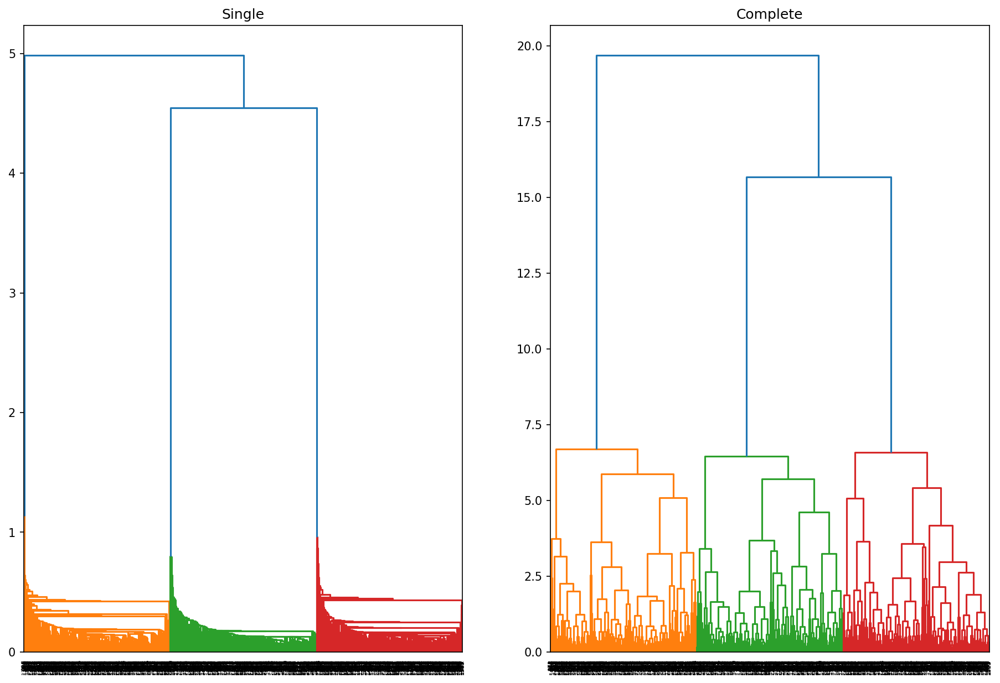

In [125]:
Z1 = linkage(Xb, method='single', metric='euclidean')
Z2 = linkage(Xb, method='complete', metric='euclidean')

plt.figure(figsize=(15, 10))
plt.subplot(1,2,1)
dendrogram(Z1)
plt.title('Single')

plt.subplot(1,2,2)
dendrogram(Z2)
plt.title('Complete')

plt.savefig('problem3Hier.pdf')
plt.show()

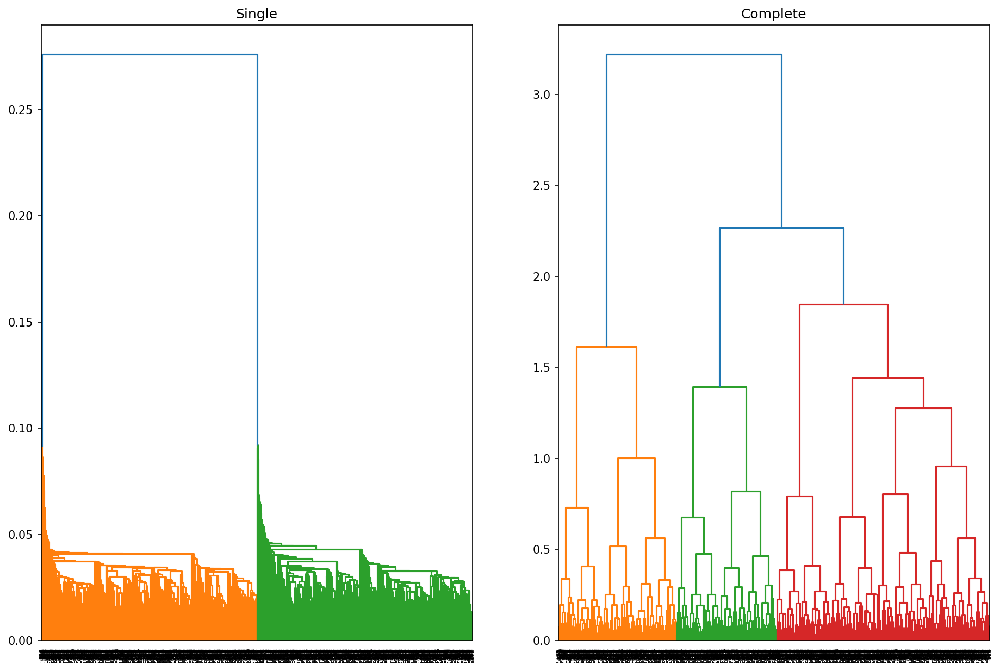

In [126]:
Z1 = linkage(Xm, method='single', metric='euclidean')
Z2 = linkage(Xm, method='complete', metric='euclidean')

plt.figure(figsize=(15, 10))
plt.subplot(1,2,1)
dendrogram(Z1)
plt.title('Single')

plt.subplot(1,2,2)
dendrogram(Z2)
plt.title('Complete')

plt.savefig('problem3HierMoons.pdf')
plt.show()



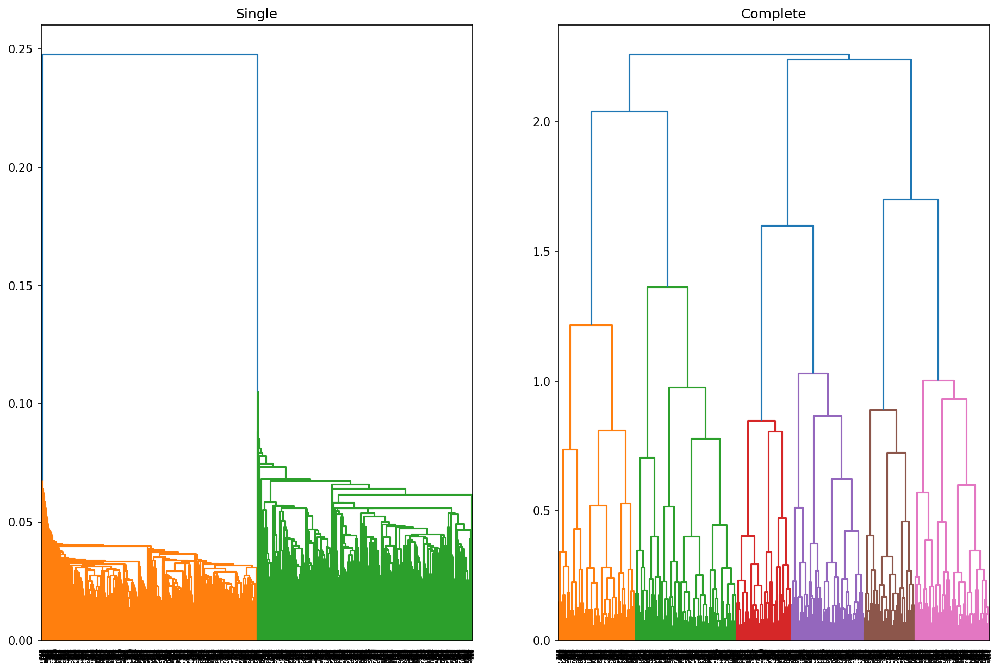

In [128]:
Z1 = linkage(Xc, method='single', metric='euclidean')
Z2 = linkage(Xc, method='complete', metric='euclidean')

plt.figure(figsize=(15, 10))
plt.subplot(1,2,1)
dendrogram(Z1)
plt.title('Single')

plt.subplot(1,2,2)
dendrogram(Z2)
plt.title('Complete')

# plt.subplot(2,2,3)
# dendrogram(Z3)
# plt.title('Average')

# plt.subplot(2,2,4)
# dendrogram(Z4)
# plt.title('Ward')

plt.savefig('problem3HierCircles.pdf')
plt.show()

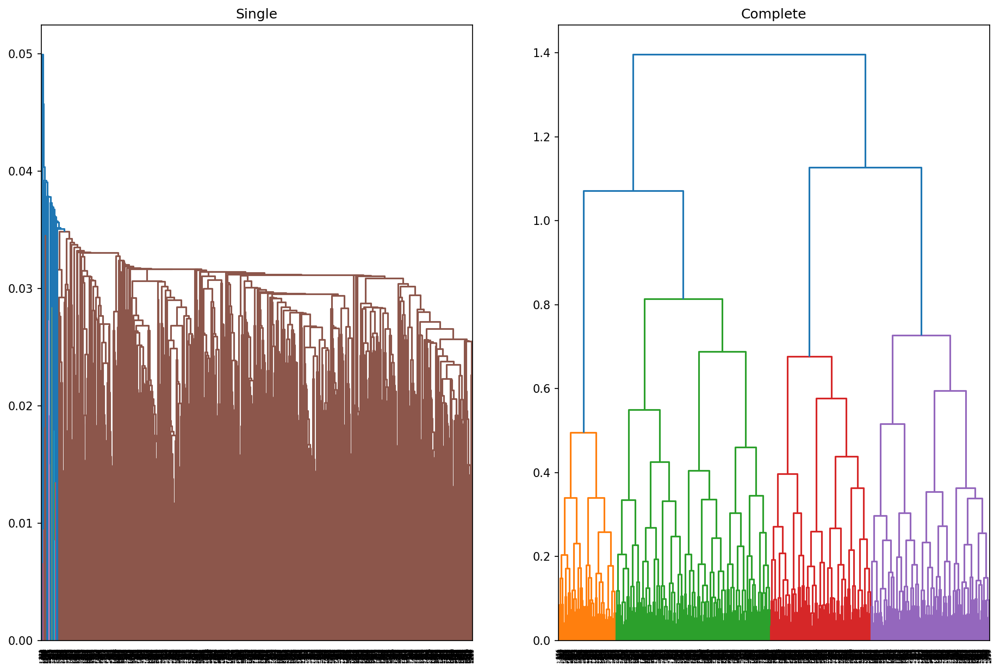

In [127]:
Z1 = linkage(X_rand, method='single', metric='euclidean')
Z2 = linkage(X_rand, method='complete', metric='euclidean')

plt.figure(figsize=(15, 10))
plt.subplot(1,2,1)
dendrogram(Z1)
plt.title('Single')

plt.subplot(1,2,2)
dendrogram(Z2)
plt.title('Complete')

plt.savefig('problem3HierRand.pdf')
plt.show()